# Projet Airbnb Ilan ZINI et Mark Killian ZINENBERG (groupe L)

#### Bibliothèques

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.svm import LinearSVR
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
import xgboost as xgb

## Exploration des données du airbnb_train et du airbnb_test

Import des données

In [3]:
train_data = pd.read_csv('airbnb_train.csv')
test_data = pd.read_csv('airbnb_test.csv')

A quoi ressemble les fichiers de données ? 

In [4]:
print("Train Data:")
train_data.head()

Train Data:


,id,log_price,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,...,last_review,latitude,longitude,name,neighbourhood,number_of_reviews,review_scores_rating,zipcode,bedrooms,beds
0,5708593,4.317488,House,Private room,"{TV,""Wireless Internet"",Kitchen,""Free parking ...",3,1.0,Real Bed,flexible,False,...,NaN,33.782712,-118.134410,Island style Spa Studio,Long Beach,0,NaN,90804,0.0,2.0
1,14483613,4.007333,House,Private room,"{""Wireless Internet"",""Air conditioning"",Kitche...",4,2.0,Real Bed,strict,False,...,2017-09-17,40.705468,-73.909439,"Beautiful and Simple Room W/2 Beds, 25 Mins to...",Ridgewood,38,86.0,11385,1.0,2.0
2,10412649,7.090077,Apartment,Entire home/apt,"{TV,""Wireless Internet"",""Air conditioning"",Kit...",6,2.0,Real Bed,flexible,False,...,NaN,38.917537,-77.031651,2br/2ba luxury condo perfect for infant / toddler,U Street Corridor,0,NaN,20009,2.0,2.0
3,17954362,3.555348,House,Private room,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1,1.0,Real Bed,flexible,True,...,2017-09-29,40.736001,-73.924248,Manhattan view from Queens. Lovely single room .,Sunnyside,19,96.0,11104,1.0,1.0
4,9969781,5.480639,House,Entire home/apt,"{TV,""Cable TV"",Internet,""Wireless Internet"",Ki...",4,1.0,Real Bed,moderate,True,...,2017-08-28,37.744896,-122.430665,Zen Captured Noe Valley House,Noe Valley,15,96.0,94131,2.0,2.0


In [5]:
print("Test Data:")
test_data.head()

Test Data:


,Unnamed: 0,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,city,...,last_review,latitude,longitude,name,neighbourhood,number_of_reviews,review_scores_rating,zipcode,bedrooms,beds
0,14282777,Apartment,Entire home/apt,"{""Wireless Internet"",""Air conditioning"",Kitche...",3,1.0,Real Bed,strict,True,NYC,...,2016-07-18,40.696524,-73.991617,Beautiful brownstone 1-bedroom,Brooklyn Heights,2,100.0,11201,1.0,1.0
1,17029381,Apartment,Entire home/apt,"{""Wireless Internet"",""Air conditioning"",Kitche...",7,1.0,Real Bed,strict,True,NYC,...,2017-09-23,40.766115,-73.989040,Superb 3BR Apt Located Near Times Square,Hell's Kitchen,6,93.0,10019,3.0,3.0
2,7824740,Apartment,Entire home/apt,"{TV,""Cable TV"",""Wireless Internet"",""Air condit...",5,1.0,Real Bed,moderate,True,NYC,...,2017-09-14,40.808110,-73.943756,The Garden Oasis,Harlem,10,92.0,10027,1.0,3.0
3,19811650,House,Entire home/apt,"{TV,""Cable TV"",Internet,""Wireless Internet"",Ki...",4,1.0,Real Bed,flexible,True,SF,...,NaN,37.772004,-122.431619,Beautiful Flat in the Heart of SF!,Lower Haight,0,NaN,94117.0,2.0,2.0
4,12410741,Apartment,Entire home/apt,"{TV,Internet,""Wireless Internet"",""Air conditio...",2,1.0,Real Bed,moderate,True,DC,...,2017-01-22,38.925627,-77.034596,Great studio in midtown DC,Columbia Heights,4,40.0,20009,0.0,1.0


Nous regardons des infos sur nos données :

In [6]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22234 entries, 0 to 22233
Data columns (total 28 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   id                      22234 non-null  int64  
 1   log_price               22234 non-null  float64
 2   property_type           22234 non-null  object 
 3   room_type               22234 non-null  object 
 4   amenities               22234 non-null  object 
 5   accommodates            22234 non-null  int64  
 6   bathrooms               22183 non-null  float64
 7   bed_type                22234 non-null  object 
 8   cancellation_policy     22234 non-null  object 
 9   cleaning_fee            22234 non-null  bool   
 10  city                    22234 non-null  object 
 11  description             22234 non-null  object 
 12  first_review            17509 non-null  object 
 13  host_has_profile_pic    22178 non-null  object 
 14  host_identity_verified  22178 non-null

In [7]:
train_data.describe()

,id,log_price,accommodates,bathrooms,latitude,longitude,number_of_reviews,review_scores_rating,bedrooms,beds
count,2.223400e+04,22234.000000,22234.000000,22183.000000,22234.000000,22234.000000,22234.000000,17256.000000,22208.000000,22199.000000
mean,1.122269e+07,4.783481,3.155573,1.236037,38.462971,-92.269305,20.670774,94.069077,1.264769,1.711473
std,6.080480e+06,0.718758,2.143870,0.586246,3.071679,21.670081,37.183731,7.782235,0.852819,1.254903
min,3.362000e+03,2.302585,1.000000,0.000000,33.339002,-122.510940,0.000000,20.000000,0.000000,0.000000
25%,6.202924e+06,4.317488,2.000000,1.000000,34.136082,-118.340633,1.000000,92.000000,1.000000,1.000000
50%,1.217425e+07,4.700480,2.000000,1.000000,40.662632,-76.994944,6.000000,96.000000,1.000000,1.000000
75%,1.639502e+07,5.220356,4.000000,1.000000,40.746358,-73.954599,23.000000,100.000000,1.000000,2.000000
max,2.120450e+07,7.600402,16.000000,8.000000,42.390248,-70.989359,505.000000,100.000000,10.000000,18.000000


Regardons s'il y a beaucoup de valeurs manquantes dans notre jeu de données: 

In [8]:
missing_value_test = test_data.isna()

print("Missing values in test data:")
print(missing_value_test.sum())

Missing values in test data:
Unnamed: 0                    0
property_type                 0
room_type                     0
amenities                     0
accommodates                  0
bathrooms                   149
bed_type                      0
cancellation_policy           0
cleaning_fee                  0
city                          0
description                   0
first_review              11139
host_has_profile_pic        132
host_identity_verified      132
host_response_rate        12824
host_since                  132
instant_bookable              0
last_review               11111
latitude                      0
longitude                     0
name                          0
neighbourhood              4786
number_of_reviews             0
review_scores_rating      11744
zipcode                     663
bedrooms                     65
beds                         96
dtype: int64


Nous remarquons qu'il y'a beaucoup de valeurs manquantes dans les données de test. Cela sera utile pour la préparation des données.

## Préparation des données

Beaucoup de valeurs sont manquantes (après la préparation des données) dans : first_review, last_review et review_scores_rating et host_since. Nous supprimons donc ces colonnes de train et test.

In [9]:
train_data.drop(columns=['first_review', 'last_review', 'review_scores_rating','host_since'], inplace=True)
test_data.drop(columns=['first_review', 'last_review', 'review_scores_rating','host_since'], inplace=True)

Dans les colonnes contenant des valeurs manquantes, nous choisissons de remplacer les valeurs manquantes par la médiane afin d'éviter des erreurs de logique (0 chambres n'a pas de sens) et afin de réduire la sensibilité due aux valeurs extrêmes.

In [10]:
train_data['bathrooms'].fillna(train_data['bathrooms'].median(), inplace=True)
train_data['bedrooms'].fillna(train_data['bedrooms'].median(), inplace=True)
train_data['beds'].fillna(train_data['beds'].median(), inplace=True)

Nous remplaçons les valeurs des colonnes booléennes / catégorielles par la valeur la plus fréquente dans la colonne.

In [11]:
train_data['host_has_profile_pic'].fillna(train_data['host_has_profile_pic'].mode()[0], inplace=True)
train_data['host_identity_verified'].fillna(train_data['host_identity_verified'].mode()[0], inplace=True)
train_data['host_response_rate'].fillna(train_data['host_response_rate'].mode()[0], inplace=True)
train_data['zipcode'].fillna(train_data['zipcode'].mode()[0], inplace=True)
train_data['neighbourhood'].fillna(train_data['neighbourhood'].mode()[0], inplace=True)

Manque-t-il encore des valeurs dans notre jeu de données ?

In [12]:
print("Missing values in test data:")
print(train_data.isnull().sum())

Missing values in test data:
id                        0
log_price                 0
property_type             0
room_type                 0
amenities                 0
accommodates              0
bathrooms                 0
bed_type                  0
cancellation_policy       0
cleaning_fee              0
city                      0
description               0
host_has_profile_pic      0
host_identity_verified    0
host_response_rate        0
instant_bookable          0
latitude                  0
longitude                 0
name                      0
neighbourhood             0
number_of_reviews         0
zipcode                   0
bedrooms                  0
beds                      0
dtype: int64


Non, il ne manque plus de valeurs

Exécution du même process pour test_data :

In [13]:
test_data['bathrooms'].fillna(train_data['bathrooms'].median(), inplace=True)
test_data['bedrooms'].fillna(train_data['bedrooms'].median(), inplace=True)
test_data['beds'].fillna(train_data['beds'].median(), inplace=True)

In [14]:
test_data['host_has_profile_pic'].fillna(train_data['host_has_profile_pic'].mode()[0], inplace=True)
test_data['host_identity_verified'].fillna(train_data['host_identity_verified'].mode()[0], inplace=True)
test_data['host_response_rate'].fillna(train_data['host_response_rate'].mode()[0], inplace=True)
test_data['zipcode'].fillna(train_data['zipcode'].mode()[0], inplace=True)
test_data['neighbourhood'].fillna(train_data['neighbourhood'].mode()[0], inplace=True)

Transformation des colonnes catégorielles en type numérique:

In [15]:
class CustomTransformation():

    def __init__(self):
        """
        Class simple pour convertir les type de propriétés en des indices numériques, utilisable pour un algo de machine learning
        """

        self.fitted = False # Indique si fit_transform a été utilisé, pour éviter d’utiliser transform sans que fit ai été appelé
        self.property2index = dict() # Dictionnaire qui va convertir le nom en indice
        self.max_index = 0 # Indique le dernier indice de la propriété.

    def fit_transform(self, dataset, colonne):

        self.fitted = True

        # Récupère les types de colonne
        types = dataset[colonne].unique()
        print("Tous les types de", colonne, ":", types)

        self.property2index = {prop:i for (i, prop) in enumerate(types)}
        self.max_index = max(list(self.property2index.values()))

        # transform
        return self.transform(dataset, colonne)
    
    def transform(self, dataset, colonne):
        # Transforme les colonnes en indice
        dataset.loc[:, colonne] = dataset[colonne].replace(self.property2index)


        # Ligne un peu moche qui fait en sorte de remplacer les lignes qui ont des nom de logement qui n’était pas dans l’entrainement
        dataset.loc[dataset[colonne].map(type).eq(str), colonne] = np.nan
        return dataset
        

Transformation des colonnes suivantes :
property_type,
room_type,
bed_type,
cancellation_policy,
city,
neighbourhood,
host_has_profile_pic,
host_identity_verified,
instant_bookable,
zipcode

In [16]:
features_transformer = CustomTransformation()

columns = ["property_type", "room_type", "bed_type", "cancellation_policy", "city", "neighbourhood",
                       "host_has_profile_pic", "host_identity_verified", "instant_bookable","zipcode"]

for col in columns:
    train_data_numerized = features_transformer.fit_transform(train_data, col)
    
train_data_numerized.head()

Tous les types de property_type : ['House' 'Apartment' 'Townhouse' 'Guest suite' 'Condominium' 'Timeshare'
 'Chalet' 'Guesthouse' 'Bungalow' 'Loft' 'In-law' 'Boat' 'Dorm' 'Other'
 'Bed & Breakfast' 'Camper/RV' 'Villa' 'Boutique hotel' 'Cabin' 'Hostel'
 'Hut' 'Yurt' 'Serviced apartment' 'Castle' 'Vacation home' 'Tent' 'Cave'
 'Tipi' 'Earth House' 'Island' 'Treehouse']
Tous les types de room_type : ['Private room' 'Entire home/apt' 'Shared room']
Tous les types de bed_type : ['Real Bed' 'Pull-out Sofa' 'Futon' 'Airbed' 'Couch']
Tous les types de cancellation_policy : ['flexible' 'strict' 'moderate' 'super_strict_30' 'super_strict_60']
Tous les types de city : ['LA' 'NYC' 'DC' 'SF' 'Chicago' 'Boston']
Tous les types de neighbourhood : ['Long Beach' 'Ridgewood' 'U Street Corridor' 'Sunnyside' 'Noe Valley'
 'West Village' 'Harlem' 'Flushing' 'Westside' 'Upper West Side'
 'Shepherd Park' 'Santa Monica' 'Mission District' 'Murray Hill'
 'Williamsburg' 'Chinatown' 'Echo Park' 'Hamilton Heights

,id,log_price,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,...,host_response_rate,instant_bookable,latitude,longitude,name,neighbourhood,number_of_reviews,zipcode,bedrooms,beds
0,5708593,4.317488,0,0,"{TV,""Wireless Internet"",Kitchen,""Free parking ...",3,1.0,0,0,False,...,100%,0,33.782712,-118.134410,Island style Spa Studio,0,0,0,0.0,2.0
1,14483613,4.007333,0,0,"{""Wireless Internet"",""Air conditioning"",Kitche...",4,2.0,0,1,False,...,100%,0,40.705468,-73.909439,"Beautiful and Simple Room W/2 Beds, 25 Mins to...",1,38,1,1.0,2.0
2,10412649,7.090077,1,1,"{TV,""Wireless Internet"",""Air conditioning"",Kit...",6,2.0,0,0,False,...,100%,0,38.917537,-77.031651,2br/2ba luxury condo perfect for infant / toddler,2,0,2,2.0,2.0
3,17954362,3.555348,0,0,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1,1.0,0,0,True,...,100%,1,40.736001,-73.924248,Manhattan view from Queens. Lovely single room .,3,19,3,1.0,1.0
4,9969781,5.480639,0,1,"{TV,""Cable TV"",Internet,""Wireless Internet"",Ki...",4,1.0,0,2,True,...,100%,1,37.744896,-122.430665,Zen Captured Noe Valley House,4,15,4,2.0,2.0


In [17]:
columns = ["property_type", "room_type", "bed_type", "cancellation_policy", "city", "neighbourhood",
                       "host_has_profile_pic", "host_identity_verified", "instant_bookable","zipcode"]

for col in columns:
    test_data_numerized = features_transformer.transform(test_data, col)
    
test_data_numerized.head()

,Unnamed: 0,property_type,room_type,amenities,accommodates,bathrooms,bed_type,cancellation_policy,cleaning_fee,city,...,host_response_rate,instant_bookable,latitude,longitude,name,neighbourhood,number_of_reviews,zipcode,bedrooms,beds
0,14282777,NaN,NaN,"{""Wireless Internet"",""Air conditioning"",Kitche...",3,1.0,NaN,NaN,True,NaN,...,100%,NaN,40.696524,-73.991617,Beautiful brownstone 1-bedroom,NaN,2,313,1.0,1.0
1,17029381,NaN,NaN,"{""Wireless Internet"",""Air conditioning"",Kitche...",7,1.0,NaN,NaN,True,NaN,...,100%,NaN,40.766115,-73.989040,Superb 3BR Apt Located Near Times Square,NaN,6,31,3.0,3.0
2,7824740,NaN,NaN,"{TV,""Cable TV"",""Wireless Internet"",""Air condit...",5,1.0,NaN,NaN,True,NaN,...,100%,NaN,40.808110,-73.943756,The Garden Oasis,NaN,10,6,1.0,3.0
3,19811650,NaN,NaN,"{TV,""Cable TV"",Internet,""Wireless Internet"",Ki...",4,1.0,NaN,NaN,True,NaN,...,100%,NaN,37.772004,-122.431619,Beautiful Flat in the Heart of SF!,NaN,0,286,2.0,2.0
4,12410741,NaN,NaN,"{TV,Internet,""Wireless Internet"",""Air conditio...",2,1.0,NaN,NaN,True,NaN,...,100%,NaN,38.925627,-77.034596,Great studio in midtown DC,NaN,4,2,0.0,1.0


Transformer 'cleaning_fee' en int

In [18]:
train_data['cleaning_fee'] = train_data['cleaning_fee'].astype('int')
test_data['cleaning_fee'] = test_data['cleaning_fee'].astype('int')

Transformer 'host_response_rate' de string à float

In [19]:
train_data['host_response_rate'] = train_data['host_response_rate'].str.rstrip('%').astype('float') / 100.0
test_data['host_response_rate'] = test_data['host_response_rate'].str.rstrip('%').astype('float') / 100.0


Traitement de amenities : choix de créer des colonnes pour chaque équipement et de remplir 1 si l'équipement est présent et 0 sinon.

In [20]:
def extract_amenities(amenities_str):
        """
        Fonction pour extraire les équipements 
        """
        # Retirons les accolades
        amenities_str = amenities_str.strip('{}')
        amenities_list = amenities_str.split(',') 
        # Retirons les guillemets supplémentaires
        amenities_list = [amenity.strip().strip('"').strip("'") for amenity in amenities_list]
        return amenities_list


all_amenities = set()
for amenity in train_data['amenities']:
        all_amenities.update(extract_amenities(amenity))
        
print("Nombre total d'équipement référencé :", len(all_amenities))

Nombre total d'équipement référencé : 125


Le fichier test contient des équipements non référencé dans le fichier train ...

In [21]:
for amenity in test_data['amenities']:
        all_amenities.update(extract_amenities(amenity))
        
print("Nombre total d'équipement référencé :", len(all_amenities))
    

Nombre total d'équipement référencé : 131


In [22]:
train_data['total_amenities'] = train_data['amenities'].apply(lambda x: len(extract_amenities(x)))
test_data['total_amenities'] = test_data['amenities'].apply(lambda x: len(extract_amenities(x)))


Calculer le nombre total d'équipements et supprimer les colonnes `amenities` individuelles
De même suppression de la colonne amenities qui n'est plus utile et des colonnes name, description qui ne sont pas utile non plus pour le machine learning. 

Choix de faire la somme des aminities, dû à :

-certains amenities sont présents dans test_data et pas dans train_data
-cela permet d'enlever le bruit et de considérer une seule colonne au lieu de plus de 100 colonnes avec des corrélations allant de NaN (du au amenities non présent dans train_data mais dans test_data), passant par -0.20 jusqu'à 0.10

In [23]:
train_data.drop(columns=['amenities'], inplace=True)
test_data.drop(columns=['amenities'], inplace=True)
train_data.drop(columns=['name', 'description'], inplace=True)
test_data.drop(columns=['name', 'description'], inplace=True)

Vérification que toutes les colonnes sont conformes (conversion numérique réussie).

In [24]:
non_numeric_columns = train_data.select_dtypes(include=['object']).columns.tolist()
for col in non_numeric_columns:
    print(f"{col}: {type(train_data[col][0])}")

print(train_data[non_numeric_columns].head())

property_type: <class 'int'>
room_type: <class 'int'>
bed_type: <class 'int'>
cancellation_policy: <class 'int'>
city: <class 'int'>
host_has_profile_pic: <class 'int'>
host_identity_verified: <class 'int'>
instant_bookable: <class 'int'>
neighbourhood: <class 'int'>
zipcode: <class 'int'>
  property_type room_type bed_type cancellation_policy city  \
0             0         0        0                   0    0   
1             0         0        0                   1    1   
2             1         1        0                   0    2   
3             0         0        0                   0    1   
4             0         1        0                   2    3   

  host_has_profile_pic host_identity_verified instant_bookable neighbourhood  \
0                    0                      0                0             0   
1                    0                      1                0             1   
2                    0                      0                0             2   
3         

Procédons aux calculs des corrélations.

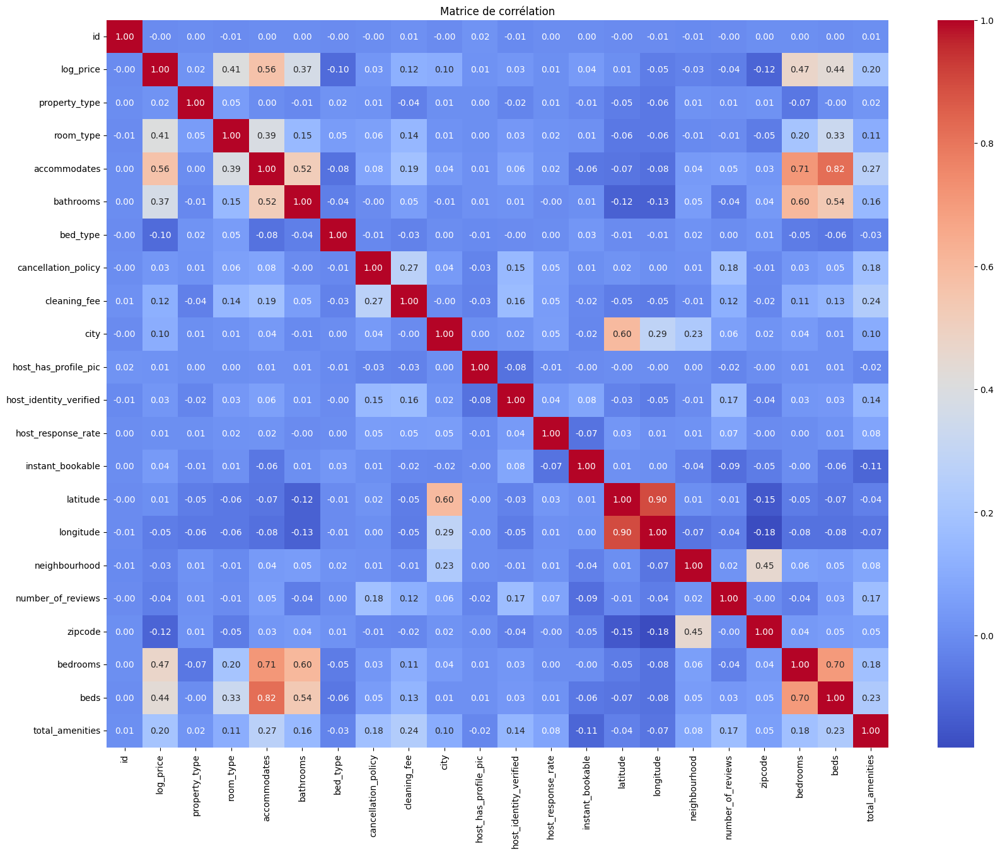

In [25]:
correlation_matrix = train_data.corr()

plt.figure(figsize=(20, 15))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title("Matrice de corrélation")
plt.show()

Corrélations de log_price avec les autres colonnes et sélection des caractéristiques les plus corrélées avec log_price

In [26]:
correlation_with_log_price = correlation_matrix['log_price'].sort_values(ascending=False)
print(correlation_with_log_price)
top_features = correlation_with_log_price.index[1::]

log_price                 1.000000
accommodates              0.564874
bedrooms                  0.472728
beds                      0.435068
room_type                 0.406694
bathrooms                 0.368856
total_amenities           0.198436
cleaning_fee              0.115116
city                      0.104990
instant_bookable          0.040482
host_identity_verified    0.030285
cancellation_policy       0.026986
property_type             0.018080
host_has_profile_pic      0.013117
host_response_rate        0.005498
latitude                  0.005231
id                       -0.002122
neighbourhood            -0.032620
number_of_reviews        -0.039138
longitude                -0.045348
bed_type                 -0.097958
zipcode                  -0.115141
Name: log_price, dtype: float64


## Entraînement

In [27]:
X = train_data[top_features]
y = train_data['log_price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Standardisation

In [28]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

Réduction de dimensionnalité avec l'ACP, cependant l'ACP n'est pas retenu car on perd en précision lorsque l'on réduit la dimensionnalité. 
Test effectué 

In [29]:
use_pca = False # Essai avec PCA ou non
if use_pca:
    pca = PCA(n_components=10) 
    X_train_scaled = pca.fit_transform(X_train_scaled)
    X_test_scaled = pca.transform(X_test_scaled)

LinearSVR peut être plus rapide pour des problèmes linéaires, mais il peut ne pas capturer des relations non linéaires aussi bien que SVR avec un noyau RBF.
Cela explique les différences de score dans la prédiction.

In [30]:
model = LinearSVR(random_state=42)
model.fit(X_train_scaled, y_train)

y_pred_train = model.predict(X_train_scaled)
y_pred_test = model.predict(X_test_scaled)

train_score = r2_score(y_train, y_pred_train)
test_score = r2_score(y_test, y_pred_test)

print(f"Score en entraînement : {train_score}")
print(f"Score en test : {test_score}")

C:\Users\markz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


Score en entraînement : 0.41186522088757105
Score en test : 0.4139481804525499


C:\Users\markz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\svm\_base.py:1250: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


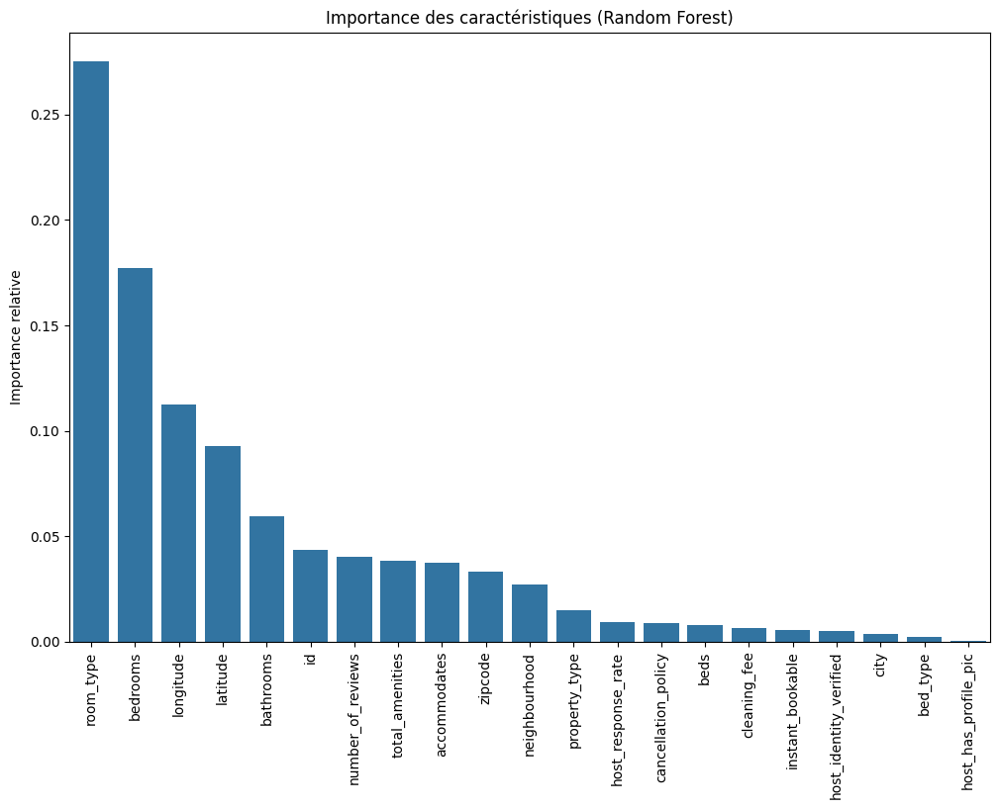

In [31]:
# Entraîner un modèle de Random Forest pour visualiser l'importance des caractéristiques
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train_scaled, y_train)

importances = rf.feature_importances_
indices = np.argsort(importances)[::-1]

plt.figure(figsize=(12, 8))
sns.barplot(x=[top_features[i] for i in indices], y=importances[indices])
plt.title('Importance des caractéristiques (Random Forest)')
plt.xticks(rotation=90)
plt.ylabel('Importance relative')
plt.show()


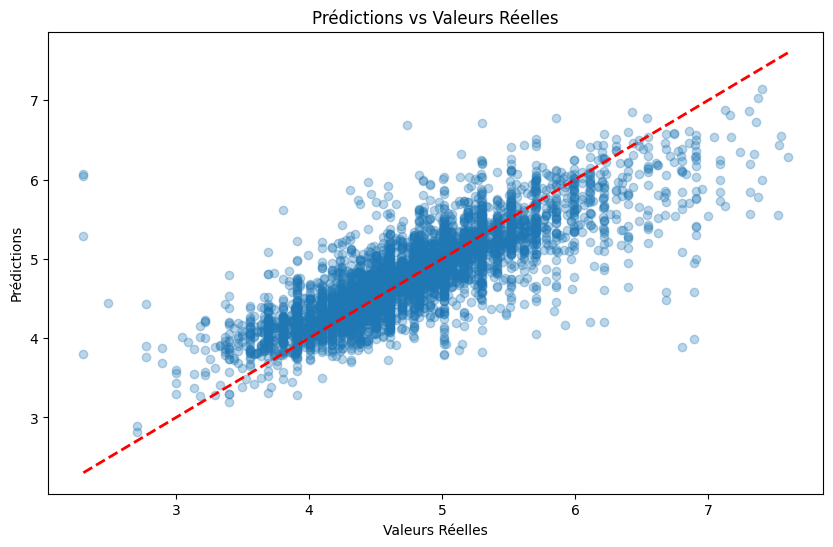

In [32]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

best_model = rf 
y_pred = best_model.predict(X_test_scaled)

plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], '--r', linewidth=2)
plt.title('Prédictions vs Valeurs Réelles')
plt.xlabel('Valeurs Réelles')
plt.ylabel('Prédictions')
plt.show()


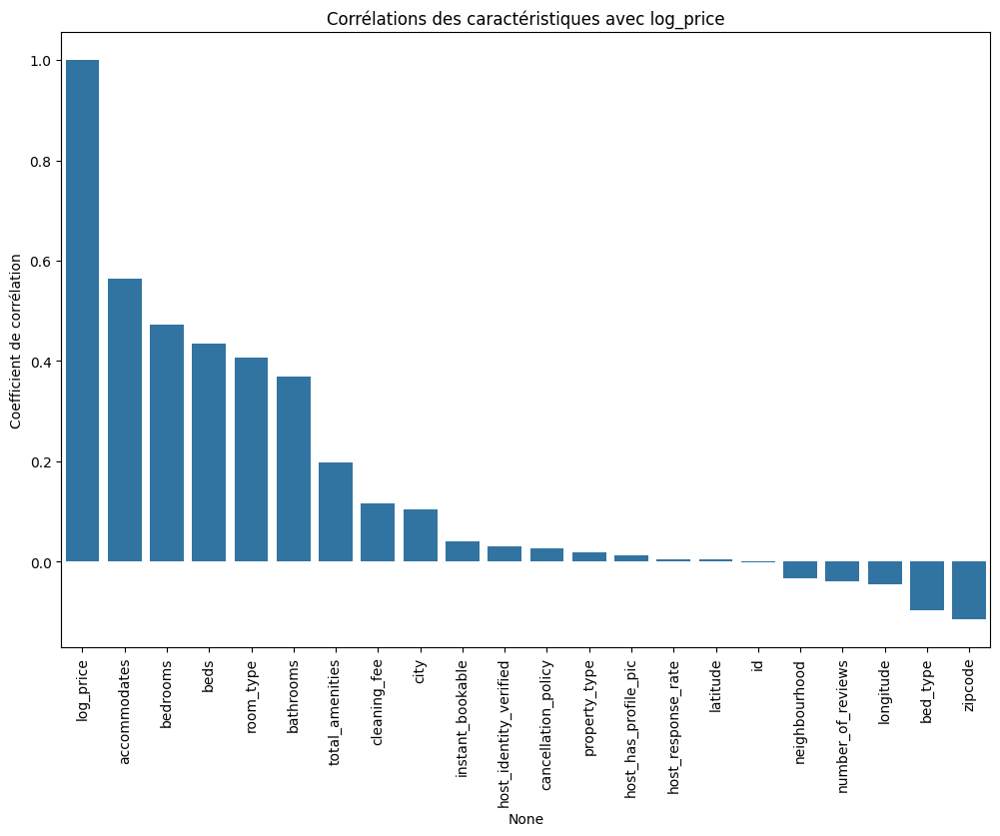

In [33]:
plt.figure(figsize=(12, 8))
correlation_with_log_price = correlation_matrix['log_price'].sort_values(ascending=False)
sns.barplot(x=correlation_with_log_price.index, y=correlation_with_log_price.values)
plt.title('Corrélations des caractéristiques avec log_price')
plt.xticks(rotation=90)
plt.ylabel('Coefficient de corrélation')
plt.show()


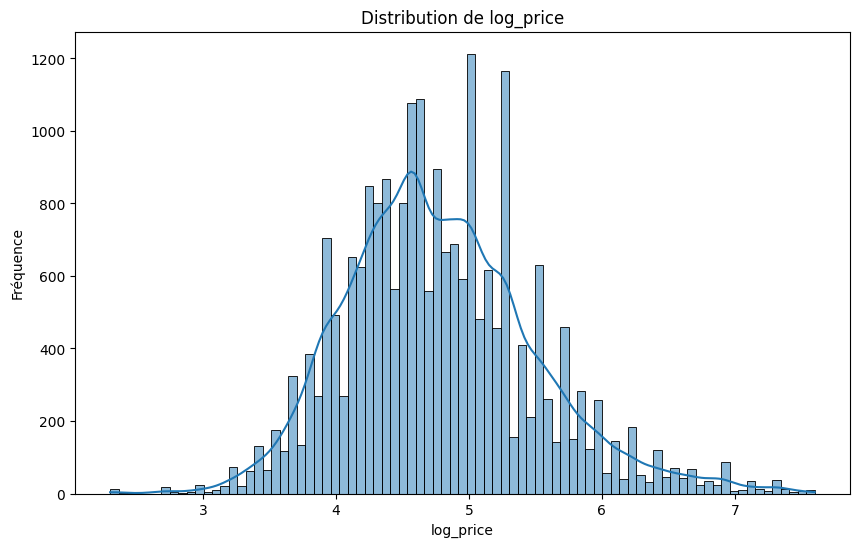

In [34]:
# Visualisation de la distribution des prix
plt.figure(figsize=(10, 6))
sns.histplot(train_data['log_price'], kde=True)
plt.title('Distribution de log_price')
plt.xlabel('log_price')
plt.ylabel('Fréquence')
plt.show()

C:\Users\markz\AppData\Local\Temp\ipykernel_25192\3365314406.py:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0, 1].set_xticklabels(correlation_with_log_price.index, rotation=90)
C:\Users\markz\AppData\Local\Temp\ipykernel_25192\3365314406.py:30: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0, 2].set_xticklabels([top_features[i] for i in indices], rotation=90)
C:\Users\markz\AppData\Local\Temp\ipykernel_25192\3365314406.py:50: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1, 2].set_xticklabels(train_data['property_type'].unique(), rotation=90)
C:\Users\markz\AppData\Local\Temp\ipykernel_25192\3365314406.py:55: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or usin

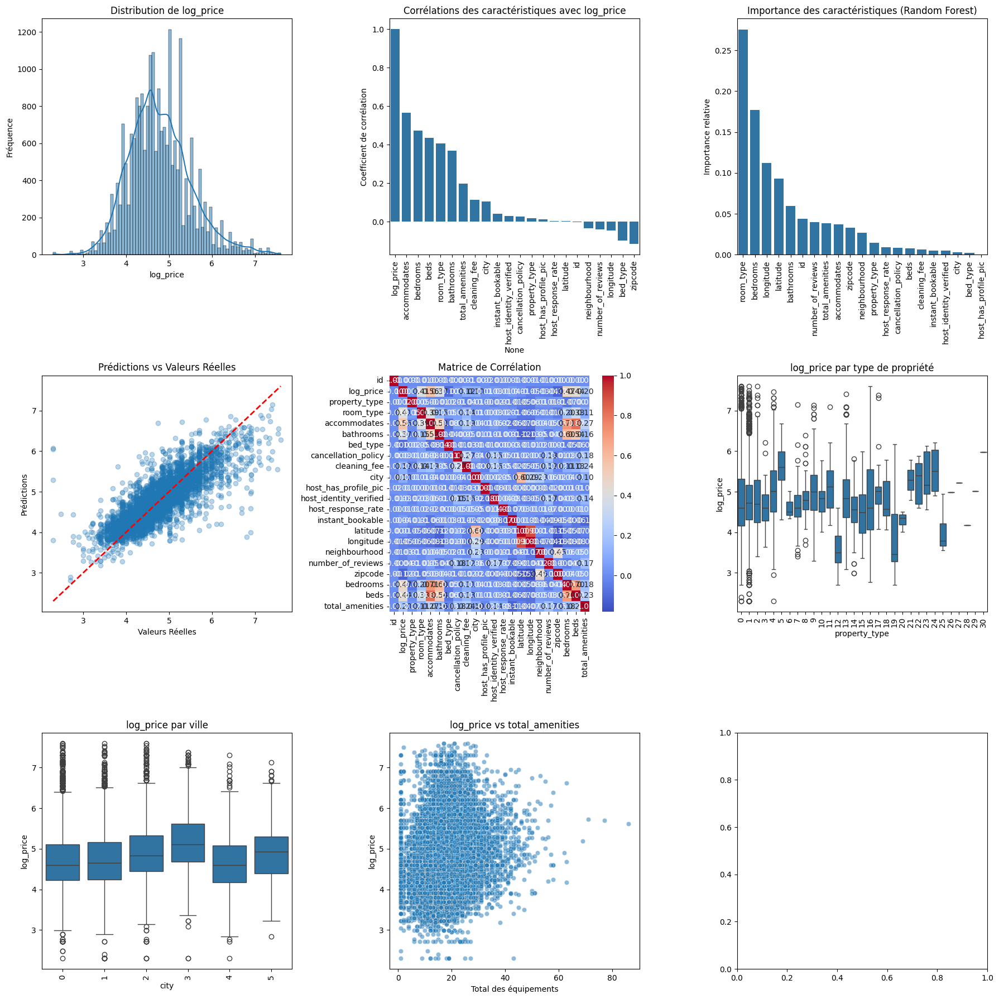

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Assurez-vous d'avoir exécuté le code pour charger et préparer les données avant de générer ces graphiques

fig, axes = plt.subplots(3, 3, figsize=(18, 18))

# 1. Distribution de log_price
sns.histplot(train_data['log_price'], kde=True, ax=axes[0, 0])
axes[0, 0].set_title('Distribution de log_price')
axes[0, 0].set_xlabel('log_price')
axes[0, 0].set_ylabel('Fréquence')

# 2. Corrélations des caractéristiques avec log_price
correlation_with_log_price = correlation_matrix['log_price'].sort_values(ascending=False)
sns.barplot(x=correlation_with_log_price.index, y=correlation_with_log_price.values, ax=axes[0, 1])
axes[0, 1].set_title('Corrélations des caractéristiques avec log_price')
axes[0, 1].set_xticklabels(correlation_with_log_price.index, rotation=90)
axes[0, 1].set_ylabel('Coefficient de corrélation')

# 3. Importance des caractéristiques (Random Forest)
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train_scaled, y_train)
importances = rf.feature_importances_
indices = np.argsort(importances)[::-1]

sns.barplot(x=[top_features[i] for i in indices], y=importances[indices], ax=axes[0, 2])
axes[0, 2].set_title('Importance des caractéristiques (Random Forest)')
axes[0, 2].set_xticklabels([top_features[i] for i in indices], rotation=90)
axes[0, 2].set_ylabel('Importance relative')

# 4. Prédictions vs Valeurs Réelles
best_model = rf  # Vous pouvez changer cela pour le modèle qui a les meilleures performances
y_pred = best_model.predict(X_test_scaled)

axes[1, 0].scatter(y_test, y_pred, alpha=0.3)
axes[1, 0].plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], '--r', linewidth=2)
axes[1, 0].set_title('Prédictions vs Valeurs Réelles')
axes[1, 0].set_xlabel('Valeurs Réelles')
axes[1, 0].set_ylabel('Prédictions')

# 5. Heatmap de la Matrice de Corrélation
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', ax=axes[1, 1])
axes[1, 1].set_title('Matrice de Corrélation')

# 6. Boxplot de log_price par type de propriété
sns.boxplot(x='property_type', y='log_price', data=train_data, ax=axes[1, 2])
axes[1, 2].set_title('log_price par type de propriété')
axes[1, 2].set_xticklabels(train_data['property_type'].unique(), rotation=90)

# 7. Distribution de log_price par ville
sns.boxplot(x='city', y='log_price', data=train_data, ax=axes[2, 0])
axes[2, 0].set_title('log_price par ville')
axes[2, 0].set_xticklabels(train_data['city'].unique(), rotation=90)

# 8. log_price vs total_amenities
sns.scatterplot(x='total_amenities', y='log_price', data=train_data, alpha=0.5, ax=axes[2, 1])
axes[2, 1].set_title('log_price vs total_amenities')
axes[2, 1].set_xlabel('Total des équipements')
axes[2, 1].set_ylabel('log_price')

plt.tight_layout()
plt.show()


In [36]:
import folium
import pandas as pd

# Créer une carte centrée sur la moyenne des latitudes et longitudes
center_lat = train_data['latitude'].mean()
center_long = train_data['longitude'].mean()
m = folium.Map(location=[center_lat, center_long], zoom_start=12)

# Ajouter des points pour chaque appartement
for idx, row in train_data.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"Price: {row['log_price']}"
    ).add_to(m)

# Afficher la carte
m.save("airbnb_map.html")

# Afficher la carte dans le notebook
m


SVR (Support Vector Regression)

Utilisé pour les problèmes de régression.
Cherche à trouver une fonction qui dévie le moins possible des cibles réelles, mais qui est aussi aussi plate que possible. Il utilise une bande de tolérance (epsilon) autour de la fonction de régression, dans laquelle les erreurs sont ignorées.

In [37]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
import xgboost as xgb

# Sélectionner les caractéristiques les plus corrélées avec `log_price`
top_features = correlation_with_log_price.index[1::]

# Créer les ensembles de données d'entraînement et de test
X = train_data[top_features]
y = train_data['log_price']

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardiser les données
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
y_train_std = scaler.fit_transform(y_train.values.reshape(-1, 1)).ravel()
y_test_std = scaler.transform(y_test.values.reshape(-1, 1)).ravel()

# Initialiser les modèles
models = {
    'Random Forest': RandomForestRegressor(n_estimators=100, random_state=42),
    'Gradient Boosting': GradientBoostingRegressor(n_estimators=100, random_state=42),
    'SVR': SVR(kernel='rbf'),
    'XGBoost': xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
}

# Entraîner et évaluer les modèles
for name, model in models.items():
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    print(f'{name}:')
    print(f'  Mean Squared Error: {mse}')
    print(f'  R^2 Score: {r2}')
    print()
    

Random Forest:
  Mean Squared Error: 0.17414941499240263
  R^2 Score: 0.6600597569052071

Gradient Boosting:
  Mean Squared Error: 0.17420933256937393
  R^2 Score: 0.6599427975936747

SVR:
  Mean Squared Error: 0.2254619243434409
  R^2 Score: 0.5598975662750707

XGBoost:
  Mean Squared Error: 0.17078144286210506
  R^2 Score: 0.6666340498177603



Text(0, 0.5, 'Log du prix en euros')

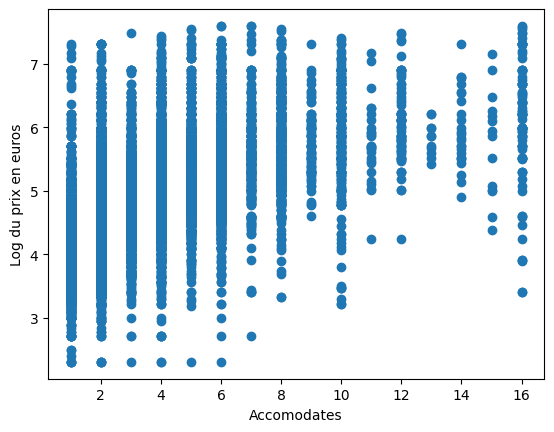

In [38]:
plt.scatter(train_data['accommodates'],train_data['log_price'])
plt.xlabel("Accomodates")
plt.ylabel("Log du prix en euros")

LATITUDE LONGITUDE ???????????

## Apprentissage 

### ACP

C’est un algorithme d’apprentissage non supervisé utilisé pour réduire la dimension d’un jeu de donnée tout en préservant le maximum de variation. 
Elle projette l’ensemble de donnée dans un espace de plus faible dimension tout en préservant le maximum de variation. 
Elle transforme les variables d’origine corrélées entre elles en des variables non corrélées appelées composantes principales qui expliquent la variance maximale des données d'origine.

Avantages: 
Réduction de dimensionnalité : la réduction du nombre de variables dans un ensemble de données simplifie l'analyse des données, améliore les performances et facilite la visualisation des données.
Sélection de fonctionnalités sélection des variables les plus importantes dans un ensemble de données
Visualisation des données : tracer des données de grande dimension en deux ou trois dimensions, ce qui facilite leur interprétation.
Multicolinéarité Identifier la structure sous-jacente des données et à créer de nouvelles variables non corrélées qui peuvent être utilisées dans le modèle de régression.
Réduction du bruit : En supprimant les composantes principales à faible variance, censées représenter du bruit,
Compression des données : la PCA peut réduire les besoins de stockage et accélérer le traitement.
Détection des valeurs aberrantes : en recherchant des points de données éloignés des autres points de l'espace des composantes principales.

FAIRE UN ACP !!!!!!!!

### Arbre de décision

Les arbres de décision peuvent être utilisés pour les tâches de régression en divisant les données en sous-groupes basés sur les caractéristiques, de manière récursive. Chaque feuille de l'arbre représente une valeur de prédiction pour le prix. Ils sont faciles à interpréter et peuvent capturer les interactions entre les caractéristiques.

In [39]:
from sklearn.tree import DecisionTreeRegressor

# Initialiser et entraîner le modèle d'arbre de décision
tree = DecisionTreeRegressor(random_state=42)
tree.fit(X_train, y_train)

# Prédictions et évaluation
y_pred = tree.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error (Decision Tree): {mse}')

Mean Squared Error (Decision Tree): 0.35018274054639725


### Descente du gradiant

La descente du gradient n'est pas un modèle en soi, mais une méthode d'optimisation utilisée pour minimiser une fonction de coût. Elle est utilisée pour entraîner divers modèles de régression, y compris les réseaux de neurones, la régression linéaire, et d'autres modèles paramétriques. Donc, bien que la descente du gradient ne soit pas un modèle directement, elle est une technique clé pour entraîner des modèles qui peuvent prédire le prix.

In [40]:
from sklearn.linear_model import SGDRegressor

# Initialiser et entraîner le modèle SGDRegressor
sgd = SGDRegressor(max_iter=1000, tol=1e-3, random_state=42)
sgd.fit(X_train, y_train)

# Prédictions et évaluation
y_pred = sgd.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error (SGD Regressor): {mse}')

Mean Squared Error (SGD Regressor): 4.791788973047283e+44


Nous allons utiliser sklearn pour pouvoir faire notre régression linéaire. Nous allons également tester deux améliorations que nous avons vu en cours : L’ajout de features polynomial et la régularisation.

In [41]:
from sklearn.datasets import load_diabetes
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error

import numpy as np

In [42]:
X, y = load_diabetes(return_X_y=True)

n_example = y.shape[0]
print(n_example)

percent_train = 0.8

print(X[:5, :])

442
[[ 0.03807591  0.05068012  0.06169621  0.02187239 -0.0442235  -0.03482076
  -0.04340085 -0.00259226  0.01990749 -0.01764613]
 [-0.00188202 -0.04464164 -0.05147406 -0.02632753 -0.00844872 -0.01916334
   0.07441156 -0.03949338 -0.06833155 -0.09220405]
 [ 0.08529891  0.05068012  0.04445121 -0.00567042 -0.04559945 -0.03419447
  -0.03235593 -0.00259226  0.00286131 -0.02593034]
 [-0.08906294 -0.04464164 -0.01159501 -0.03665608  0.01219057  0.02499059
  -0.03603757  0.03430886  0.02268774 -0.00936191]
 [ 0.00538306 -0.04464164 -0.03638469  0.02187239  0.00393485  0.01559614
   0.00814208 -0.00259226 -0.03198764 -0.04664087]]


Dans la cellule suivante, vous allez faire en sorte de repartir les données entrain un set d’entraînement et un set de test (avec une répartition à 80% dans votre jeu d’entraînement et 20% dans le test)

In [43]:
percent_train = 0.8
all_ids = np.arange(n_example)
np.random.shuffle(all_ids)
train_id = all_ids[:int(percent_train*n_example)]
test_id = all_ids[int(percent_train*n_example):]

X_train, y_train = X[train_id], y[train_id]
X_test, y_test = X[test_id], y[test_id]

print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(353, 10) (353,)
(89, 10) (89,)


In [44]:
Maintenant, vous allez pouvoir utiliser l’objet LinearRegression pour faire l’apprentissage sur le jeu de données d’entraînement. Affichez ensuite le score mean_square_error sur le jeu de données d’entraînement et sur le jeu de données de test.

SyntaxError: invalid character '’' (U+2019) (3401221946.py, line 1)

In [ ]:
lin = LinearRegression()
lin.fit(X_train, y_train)
y_pred = lin.predict(X_test)

y_pred_train = lin.predict(X_train)
y_pred_test = lin.predict(X_test)

train_score = mean_squared_error(y_pred=y_pred_train, y_true=y_train)
test_score = mean_squared_error(y_pred=y_pred_test, y_true=y_test)

print(f"For Linear Regression : Train Score {train_score} Test Score {test_score}")

In [ ]:
Que se passe t’il si dans mon jeu de données, il y a pleins de colonnes qui n’apporte pas d’informations sur mon jeu de donnée ? Pour connaître la réponse à cette question, créez une fonction add_random_features qui prend entrée un jeu de données et un nombre de colonne, et qui ajoute autant de colonne de bruit (chaque colonne doit être aléatoire) qu’indiqué en paramètres.

In [ ]:
def add_random_features(dataset, n_col):

    n_example = dataset.shape[0]

    useless_features = np.random.random((n_example, n_col))

    print(dataset.shape, useless_features.shape)
    return np.column_stack((dataset, useless_features))

In [ ]:
Maintenant, essayer d’ajouter 1, puis 5, puis 10, puis 100, puis 200 colonnes de bruit. Que constatez-vous sur l’évolution du score en train et en test ?

In [ ]:
for n_random_col in [1,5,10,100, 200]:
    X_train_with_randomness = add_random_features(X_train, n_random_col)
    X_test_with_randomness = add_random_features(X_test, n_random_col)

    lin = LinearRegression()
    lin.fit(X_train_with_randomness, y_train)

    y_pred_train = lin.predict(X_train_with_randomness)
    y_pred_test = lin.predict(X_test_with_randomness)

    train_score = mean_squared_error(y_pred=y_pred_train, y_true=y_train)
    test_score = mean_squared_error(y_pred=y_pred_test, y_true=y_test)

    print(f"For {n_random_col} random columns : Train Score {train_score} Test Score {test_score}")

# Plus on ajoute des colonnes de bruit, plus l’erreur en train diminue, mais l’erreur en test augmente
# Le modèle sur-apprend!

In [ ]:
Passons à la regression polynomial, utilisez l’objet PolynomialFeatures pour créer pleins de colonnes contenant le carré (et éventuellement plus) des caractéristiques.
Vous pouvez utiliser pour cela "make_pipeline" qui permet de créer un pipeline de transformation, celui-ci va contenir une instance de PolynomialFeatures et une instance de LinearRegression.

In [ ]:
Augmentez le degré du polynome (vous pouvez tester 2,3 et 4), que constatez-vous ?

In [ ]:
for n_poly_feat in [2, 3, 4]:
    
    poly = make_pipeline(PolynomialFeatures(n_poly_feat), LinearRegression())
    poly.fit(X_train, y_train)

    y_pred_train = poly.predict(X_train)
    y_pred_test = poly.predict(X_test)

    train_score = mean_squared_error(y_pred=y_pred_train, y_true=y_train)
    test_score = mean_squared_error(y_pred=y_pred_test, y_true=y_test)

    print(f"For {n_poly_feat} polynomial features : Train Score {train_score} Test Score {test_score}")

# Le modèle sur-apprend énormément, son erreur en train est quasiment zéro, mais il ne généralise pas du tout!

In [ ]:
On a vu dans le cours le moyen de faire de la régression linéaire avec de la régularization. L’idée est de forcer que certaines caractéristiques soit à 0 à la fin du processus d’entraînement (et donc d’ignorer certaines caractéristiques qui ont l’air de ne pas servir)
Dans sklearn, la régression + la régularisation L2 s’appelle Ridge. Elle prend en entrée un paramètre alpha qui va "équilibrer" le coût entre la tâche de regression et le fait de mettre les poids à zéros.

Relancez l’apprentissage de ce jeu de données (avec les features polynomial) avec une Ridge, et essayez différentes valeurs de alpha, que constatez-vous ? (Essayez avec les valeurs [1e-3, 1e-2 et 1e-1])

In [ ]:
for alpha in [1e-3, 1e-2, 1e-1]:
    for n_poly_feat in [2, 3, 4]:    
        
        polyRidge = make_pipeline(PolynomialFeatures(n_poly_feat), Ridge(alpha=alpha))
        polyRidge.fit(X_train, y_train)

        y_pred = polyRidge.predict(X_test)
        print(mean_squared_error(y_pred=y_pred, y_true=y_test))

        y_pred_train = polyRidge.predict(X_train)
        y_pred_test = polyRidge.predict(X_test)

        train_score = mean_squared_error(y_pred=y_pred_train, y_true=y_train)
        test_score = mean_squared_error(y_pred=y_pred_test, y_true=y_test)

        print(f"For {n_poly_feat} polynomial features, alpha = {alpha} : Train Score {train_score} Test Score {test_score}")

# Quand alpha est assez élevé, la ridge limite les problèmes du polynome de fort degré !